In [28]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

## Experience Analytics

In [3]:
# Load the dataset into a pandas DataFrame
df = pd.read_csv('../data/cleaned_data.csv')

## average TCP retransmission per customer

In [4]:
# Calculate average TCP retransmission per customer
avg_tcp_retransmission = df.groupby('MSISDN/Number')[['TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)']].mean()
print(avg_tcp_retransmission)


               TCP DL Retrans. Vol (Bytes)  TCP UL Retrans. Vol (Bytes)
MSISDN/Number                                                          
3.360304e+10                  1.772524e+06                 38615.655718
3.360304e+10                  8.300000e+02                169143.000000
3.360304e+10                  1.318000e+03                 11614.000000
3.360304e+10                  5.742955e+05                  1436.000000
3.360305e+10                  8.820000e+02                  2102.000000
...                                    ...                          ...
3.370000e+10                  2.155820e+05                   484.000000
3.370000e+10                  7.732280e+05                122288.000000
3.370000e+10                  6.785000e+03                  6755.000000
3.370000e+10                  6.472184e+06                 74526.000000
3.373167e+10                  2.145460e+06                 49049.154865

[88753 rows x 2 columns]


## average RTT per customer

In [5]:
# Calculate average RTT per customer
avg_rtt = df.groupby('MSISDN/Number')[['Avg RTT DL (ms)', 'Avg RTT UL (ms)']].mean()
# Display the average RTT per customer
print(avg_rtt)

               Avg RTT DL (ms)  Avg RTT UL (ms)
MSISDN/Number                                  
3.360304e+10         50.576642         6.706204
3.360304e+10         34.000000         1.000000
3.360304e+10        121.000000         8.000000
3.360304e+10         35.000000        17.250000
3.360305e+10         43.000000         3.000000
...                        ...              ...
3.370000e+10         33.000000        29.500000
3.370000e+10        121.000000        11.000000
3.370000e+10         20.000000         9.000000
3.370000e+10         20.000000         1.000000
3.373167e+10         54.550257         9.631979

[88753 rows x 2 columns]


## Aggregate handset type per customer

In [6]:
# Aggregate handset type per customer
handset_type = df.groupby('MSISDN/Number')['Handset Type'].first()
print(handset_type)

MSISDN/Number
3.360304e+10      Samsung Galaxy A5 Sm-A520F
3.360304e+10     Samsung Galaxy J3 (Sm-J330)
3.360304e+10     Apple iPhone 6 Plus (A1524)
3.360304e+10    Samsung Galaxy S8 (Sm-G950F)
3.360305e+10         Apple iPhone 6S (A1633)
                            ...             
3.370000e+10     Samsung Galaxy J5 (Sm-J530)
3.370000e+10          Apple iPhone 6 (A1586)
3.370000e+10                  Huawei P9 Lite
3.370000e+10               Samsung Galaxy J7
3.373167e+10     Samsung Galaxy J3 (Sm-J330)
Name: Handset Type, Length: 88753, dtype: object


## average throughput per customer

In [7]:
# Calculate average throughput per customer
avg_throughput = df.groupby('MSISDN/Number')[['Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']].mean()
print(avg_throughput)

               Avg Bearer TP DL (kbps)  Avg Bearer TP UL (kbps)
MSISDN/Number                                                  
3.360304e+10               8748.567518               527.170316
3.360304e+10                 43.000000                63.000000
3.360304e+10               1268.000000               261.000000
3.360304e+10              25014.625000              1405.250000
3.360305e+10               1447.000000               361.000000
...                                ...                      ...
3.370000e+10                  6.000000                 9.000000
3.370000e+10               4073.000000               402.000000
3.370000e+10               8018.000000               174.000000
3.370000e+10                  6.000000                 9.000000
3.373167e+10              12107.994545               768.321553

[88753 rows x 2 columns]


## Aggregate all information per customer

In [8]:


# Aggregate all information per customer
aggregated_info = pd.concat([avg_tcp_retransmission, avg_rtt, handset_type, avg_throughput], axis=1)

print(aggregated_info.to_string())




               TCP DL Retrans. Vol (Bytes)  TCP UL Retrans. Vol (Bytes)  Avg RTT DL (ms)  Avg RTT UL (ms)                                                                                 Handset Type  Avg Bearer TP DL (kbps)  Avg Bearer TP UL (kbps)
MSISDN/Number                                                                                                                                                                                                                                           
3.360304e+10                  1.772524e+06                 38615.655718        50.576642         6.706204                                                                   Samsung Galaxy A5 Sm-A520F              8748.567518               527.170316
3.360304e+10                  8.300000e+02                169143.000000        34.000000         1.000000                                                                  Samsung Galaxy J3 (Sm-J330)                43.000000                63.000000
3.36

## Top 10 TCP values

In [9]:
# Top 10 TCP values
top_tcp_values = df[['TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)']].stack().nlargest(10)
bottom_tcp_values = df[['TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)']].stack().nsmallest(10)
most_frequent_tcp_values = pd.concat([df['TCP DL Retrans. Vol (Bytes)'].value_counts().nlargest(10), df['TCP UL Retrans. Vol (Bytes)'].value_counts().nlargest(10)])

print("Top 10 TCP values:")
print(top_tcp_values)
print("\nBottom 10 TCP values:")
print(bottom_tcp_values)
print("\nMost frequent TCP values:")
print(most_frequent_tcp_values)


Top 10 TCP values:
4   TCP DL Retrans. Vol (Bytes)    7730008.25
5   TCP DL Retrans. Vol (Bytes)    7730008.25
6   TCP DL Retrans. Vol (Bytes)    7730008.25
7   TCP DL Retrans. Vol (Bytes)    7730008.25
8   TCP DL Retrans. Vol (Bytes)    7730008.25
9   TCP DL Retrans. Vol (Bytes)    7730008.25
10  TCP DL Retrans. Vol (Bytes)    7730008.25
11  TCP DL Retrans. Vol (Bytes)    7730008.25
12  TCP DL Retrans. Vol (Bytes)    7730008.25
13  TCP DL Retrans. Vol (Bytes)    7730008.25
dtype: float64

Bottom 10 TCP values:
12865   TCP UL Retrans. Vol (Bytes)    1.0
14746   TCP UL Retrans. Vol (Bytes)    1.0
34872   TCP UL Retrans. Vol (Bytes)    1.0
37161   TCP UL Retrans. Vol (Bytes)    1.0
37162   TCP UL Retrans. Vol (Bytes)    1.0
73412   TCP UL Retrans. Vol (Bytes)    1.0
76958   TCP UL Retrans. Vol (Bytes)    1.0
76959   TCP UL Retrans. Vol (Bytes)    1.0
88168   TCP UL Retrans. Vol (Bytes)    1.0
121267  TCP UL Retrans. Vol (Bytes)    1.0
dtype: float64

Most frequent TCP values:
7730008.25 

## Top 10 RTT values

In [10]:
top_rtt_values = df[['Avg RTT DL (ms)', 'Avg RTT UL (ms)']].stack().nlargest(10)
bottom_rtt_values = df[['Avg RTT DL (ms)', 'Avg RTT UL (ms)']].stack().nsmallest(10)
most_frequent_rtt_values = pd.concat([df['Avg RTT DL (ms)'].value_counts().nlargest(10), df['Avg RTT UL (ms)'].value_counts().nlargest(10)])
print("\nTop 10 RTT values:")
print(top_rtt_values)
print("\nBottom 10 RTT values:")
print(bottom_rtt_values)
print("\nMost frequent RTT values:")
print(most_frequent_rtt_values)



Top 10 RTT values:
2    Avg RTT DL (ms)    121.0
3    Avg RTT DL (ms)    121.0
10   Avg RTT DL (ms)    121.0
20   Avg RTT DL (ms)    121.0
21   Avg RTT DL (ms)    121.0
51   Avg RTT DL (ms)    121.0
58   Avg RTT DL (ms)    121.0
59   Avg RTT DL (ms)    121.0
136  Avg RTT DL (ms)    121.0
140  Avg RTT DL (ms)    121.0
dtype: float64

Bottom 10 RTT values:
44   Avg RTT UL (ms)    0.0
45   Avg RTT UL (ms)    0.0
46   Avg RTT UL (ms)    0.0
89   Avg RTT UL (ms)    0.0
90   Avg RTT UL (ms)    0.0
164  Avg RTT UL (ms)    0.0
175  Avg RTT UL (ms)    0.0
287  Avg RTT UL (ms)    0.0
329  Avg RTT UL (ms)    0.0
351  Avg RTT UL (ms)    0.0
dtype: float64

Most frequent RTT values:
121.0    16341
28.0      4692
27.0      4433
34.0      4171
35.0      3623
37.0      3344
36.0      3310
26.0      3263
29.0      3148
24.0      3122
5.0      18463
2.0      18238
1.0      16741
29.5     16298
4.0      12545
3.0       9396
6.0       9259
0.0       5695
7.0       4901
8.0       3657
Name: count, dtype: 

## Top 10 Throughput values

In [11]:

# Top 10 Throughput values
top_throughput_values = df[['Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']].stack().nlargest(10)
bottom_throughput_values = df[['Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']].stack().nsmallest(10)
most_frequent_throughput_values = pd.concat([df['Avg Bearer TP DL (kbps)'].value_counts().nlargest(10), df['Avg Bearer TP UL (kbps)'].value_counts().nlargest(10)])


print("\nTop 10 Throughput values:")
print(top_throughput_values)
print("\nBottom 10 Throughput values:")
print(bottom_throughput_values)
print("\nMost frequent Throughput values:")
print(most_frequent_throughput_values)



Top 10 Throughput values:
51   Avg Bearer TP DL (kbps)    49999.25
68   Avg Bearer TP DL (kbps)    49999.25
76   Avg Bearer TP DL (kbps)    49999.25
114  Avg Bearer TP DL (kbps)    49999.25
121  Avg Bearer TP DL (kbps)    49999.25
129  Avg Bearer TP DL (kbps)    49999.25
143  Avg Bearer TP DL (kbps)    49999.25
146  Avg Bearer TP DL (kbps)    49999.25
150  Avg Bearer TP DL (kbps)    49999.25
158  Avg Bearer TP DL (kbps)    49999.25
dtype: float64

Bottom 10 Throughput values:
595   Avg Bearer TP DL (kbps)    0.0
      Avg Bearer TP UL (kbps)    0.0
1103  Avg Bearer TP UL (kbps)    0.0
2421  Avg Bearer TP DL (kbps)    0.0
      Avg Bearer TP UL (kbps)    0.0
3326  Avg Bearer TP UL (kbps)    0.0
4630  Avg Bearer TP UL (kbps)    0.0
4819  Avg Bearer TP UL (kbps)    0.0
7019  Avg Bearer TP UL (kbps)    0.0
9111  Avg Bearer TP DL (kbps)    0.0
dtype: float64

Most frequent Throughput values:
49999.25    12675
23.00        7318
43.00        4347
44.00        4183
6.00         3907
22.00    

## Distribution of average throughput per handset type

In [31]:
# Distribution of average throughput per handset type
avg_throughput_per_handset = df.groupby('Handset Type')[['Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)']].mean()

print("Distribution of the average throughput per handset type:")
print(avg_throughput_per_handset)



Distribution of the average throughput per handset type:
                                                    Avg Bearer TP DL (kbps)  \
Handset Type                                                                  
A-Link Telecom I. Cubot A5                                     23184.000000   
A-Link Telecom I. Cubot Note Plus                               6527.000000   
A-Link Telecom I. Cubot Note S                                  8515.000000   
A-Link Telecom I. Cubot Nova                                   49999.250000   
A-Link Telecom I. Cubot Power                                  49999.250000   
...                                                                     ...   
Zte Zte Blade C2 Smartphone Android By Sfr Star...                44.500000   
Zyxel Communicat. Lte7460                                      39741.000000   
Zyxel Communicat. Sbg3600                                      49999.250000   
Zyxel Communicat. Zyxel Wah7706                                 1263.00000

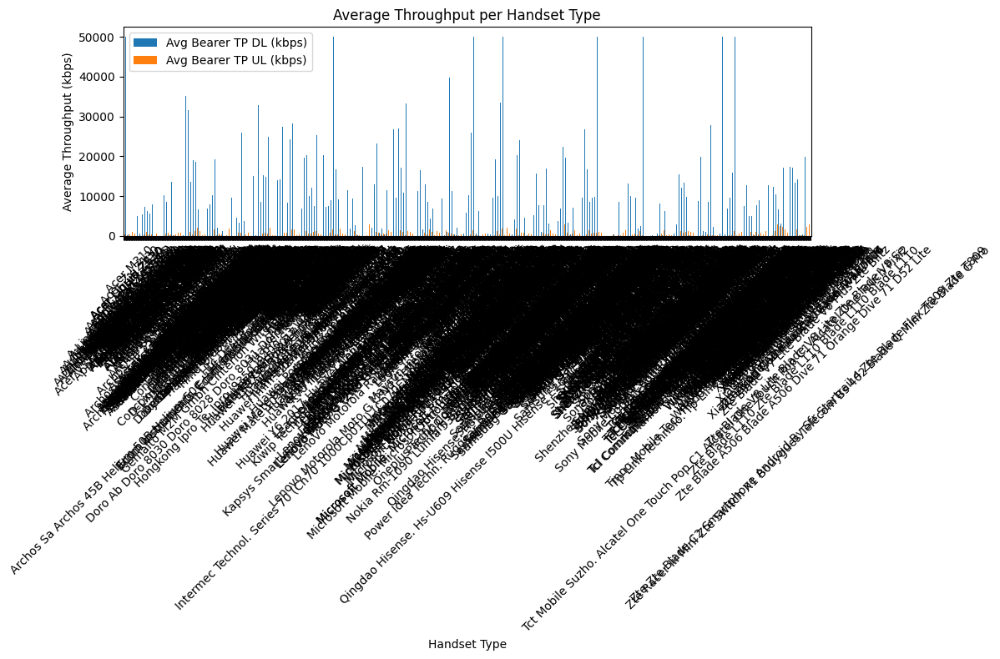

In [32]:
# Plot the distribution of the average throughput per handset type
avg_throughput_per_handset.plot(kind='bar', figsize=(12, 8))
plt.title('Average Throughput per Handset Type')
plt.xlabel('Handset Type')
plt.ylabel('Average Throughput (kbps)')
plt.xticks(rotation=45)

# Adjust layout for better spacing
plt.tight_layout()

plt.show()


## Average TCP retransmission per handset type

In [13]:
# Average TCP retransmission per handset type
avg_tcp_retransmission_per_handset = df.groupby('Handset Type')[['TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)']].mean()
print("\nAverage TCP retransmission per handset type:")
print(avg_tcp_retransmission_per_handset)





Average TCP retransmission per handset type:
                                                    TCP DL Retrans. Vol (Bytes)  \
Handset Type                                                                      
A-Link Telecom I. Cubot A5                                         7.718470e+05   
A-Link Telecom I. Cubot Note Plus                                  6.023490e+05   
A-Link Telecom I. Cubot Note S                                     7.730008e+06   
A-Link Telecom I. Cubot Nova                                       1.358400e+05   
A-Link Telecom I. Cubot Power                                      7.799000e+03   
...                                                                         ...   
Zte Zte Blade C2 Smartphone Android By Sfr Star...                 3.866334e+06   
Zyxel Communicat. Lte7460                                          7.730008e+06   
Zyxel Communicat. Sbg3600                                          7.730008e+06   
Zyxel Communicat. Zyxel Wah7706          

# The distribution of the average throughput per handset type provides insights into the performance of different handsets in terms of data transfer speeds. It can help identify which handset types are associated with higher or lower average throughput, which may be indicative of the quality of the devices or their compatibility with the network.

# The average TCP retransmission per handset type reveals the level of packet retransmissions occurring for different handsets. This can indicate potential issues with network connectivity, device compatibility, or hardware/software performance for specific handset types.

In [17]:
# Select the relevant experience metrics for clustering
experience_metrics = df[['Avg RTT DL (ms)', 'Avg RTT UL (ms)', 'Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)', 'TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)']]


In [18]:
# Standardize the data
scaler = StandardScaler()
scaled_experience_metrics = scaler.fit_transform(experience_metrics)

In [26]:
# Perform k-means clustering (k=3) with explicit setting of n_init
kmeans = KMeans(n_clusters=3, n_init=10, random_state=42)

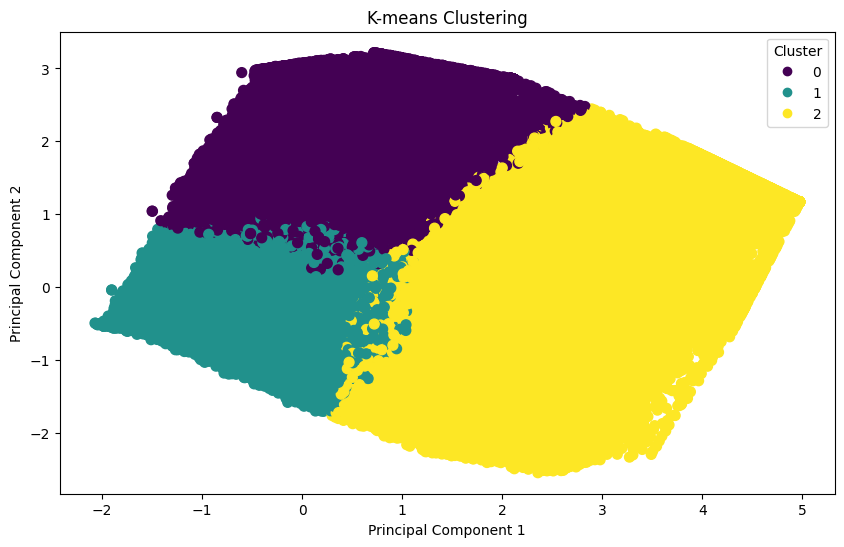

In [29]:


# Reduce dimensionality using PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(scaled_experience_metrics)

# Create a DataFrame with the principal components and cluster assignments
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = df['cluster']

# Visualize the clusters
plt.figure(figsize=(10, 6))
scatter = plt.scatter(pca_df['PC1'], pca_df['PC2'], c=pca_df['cluster'], cmap='viridis', s=50)
plt.title('K-means Clustering')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(*scatter.legend_elements(), title='Cluster')
plt.show()
